#The Sparks Foundation
#GRIPAUGUST21 
##Social distance detector

###By: Ayman Sajjad
###File located at: 

Importing Libraries

In [26]:
import matplotlib.pyplot as plt
import glob # for listing files
from google.colab import drive
import numpy as np
import cv2
import os
import tensorflow as tf
from google.colab.patches import cv2_imshow
import imutils
from scipy.spatial import distance as dist


Initializing Variables

In [27]:
# initialize minimum probability to filter weak detections along with the threshold when applying non-maxima suppression
MIN_CONF = 0.5
NMS_THRESH = 0.3
# boolean indicating if NVIDIA CUDA GPU should be used
USE_GPU = False
# define the minimum safe distance (in pixels) that two people can be from each other
MIN_DISTANCE = 50

Cloning Darknet for YOLO (for object detection)

In [28]:
!git clone https://github.com/AlexeyAB/darknet.git


fatal: destination path 'darknet' already exists and is not an empty directory.


Downloading YOLO3 weights, Configration and names fileS and adding into darknet folder 

In [29]:
#Downloading YOLO3 weights file
_URL2 = 'https://pjreddie.com/media/files/yolov3.weights'
weights = tf.keras.utils.get_file('yolov3.weights', origin=_URL2, extract=True)
!cp /root/.keras/datasets/yolov3.weights /content/darknet/yolov3.weights
weights = os.path.join('/content/darknet', 'yolov3.weights')
!find $weights -print

#adding YOLO3 config file in darknet
cfg = os.path.join('/content/darknet/cfg', 'yolov3.cfg')
!find $cfg -print
net = cv2.dnn.readNetFromDarknet(cfg,weights)
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CPU)

#adding YOLO3 coco names file in darknet
names = os.path.join('/content/darknet/data', 'coco.names')
LABELS = open(names).read().strip().split("\n")

np.random.seed(42)
COLORS = np.random.randint(0, 255, size=(len(LABELS), 3),dtype="uint8")
COLORS[2]

# determine only the *output* layer names that we need from YOLO
ln = [net.getLayerNames()[i[0] - 1] for i in net.getUnconnectedOutLayers()]


/content/darknet/yolov3.weights
/content/darknet/cfg/yolov3.cfg


Opening video file to read and detect social distance and making an output file by using openCV 




In [30]:
cap = cv2.VideoCapture('/content/PETS2009.mp4')
writer=None
ret, frame=cap.read()
fourcc = cv2.VideoWriter_fourcc(*'XVID')
writer = cv2.VideoWriter('/content/out.avi', fourcc, 25,(frame.shape[1], frame.shape[0]), True)


looping over the frames from the video stream and detecting social distance

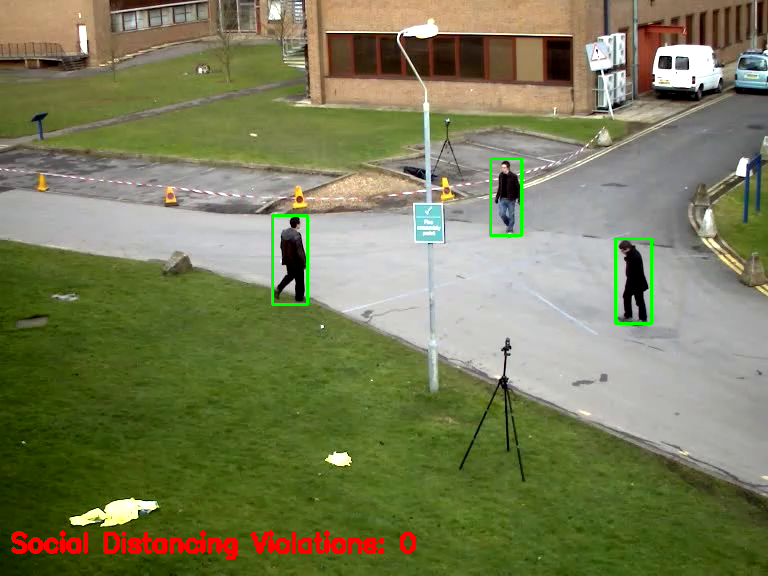

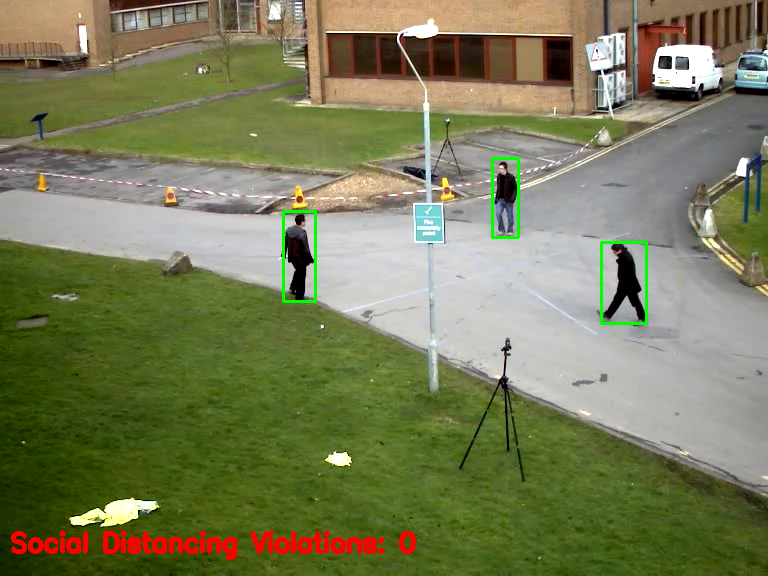

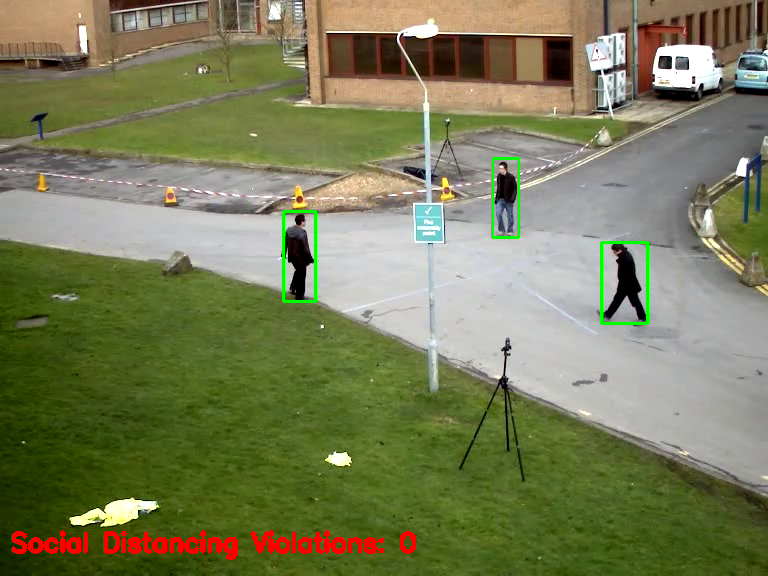

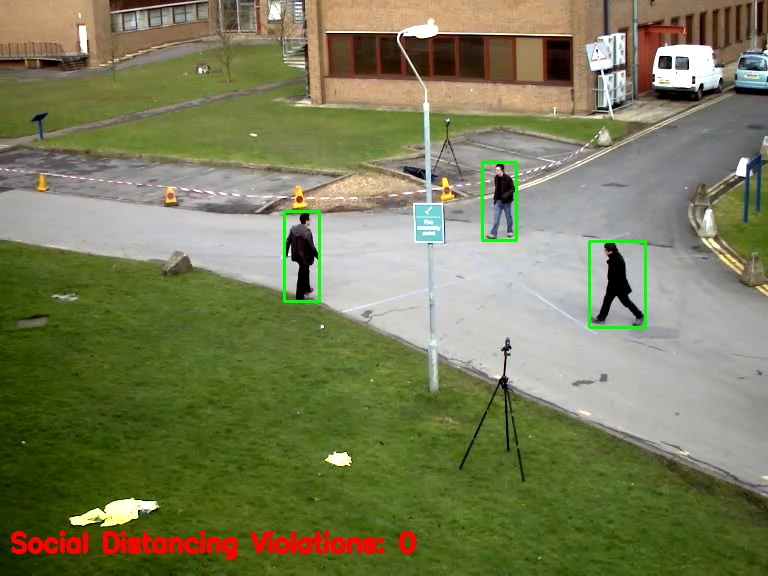

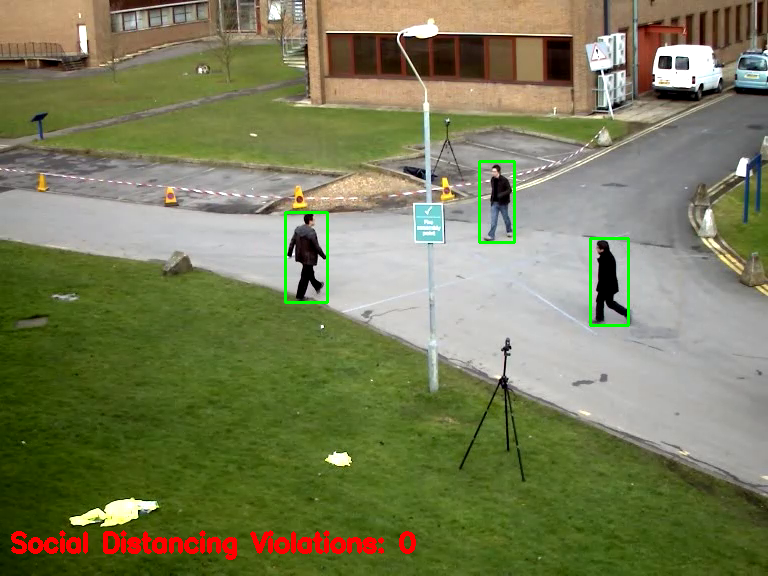

...

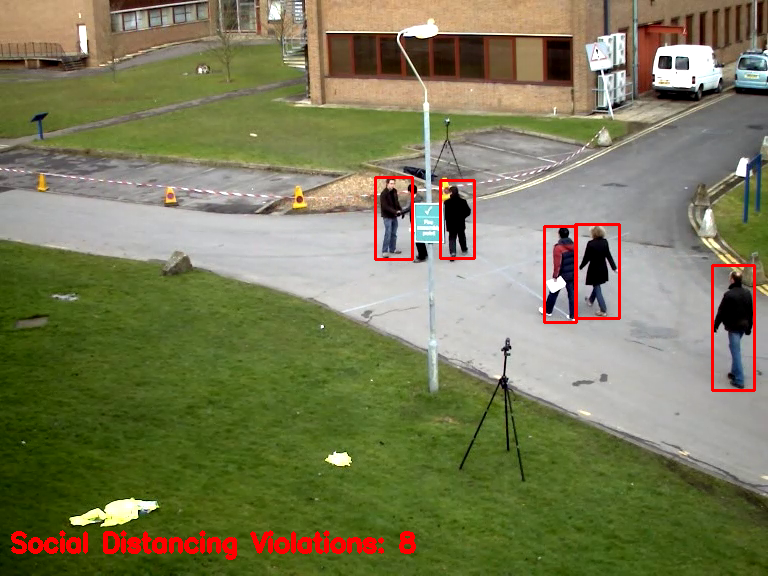

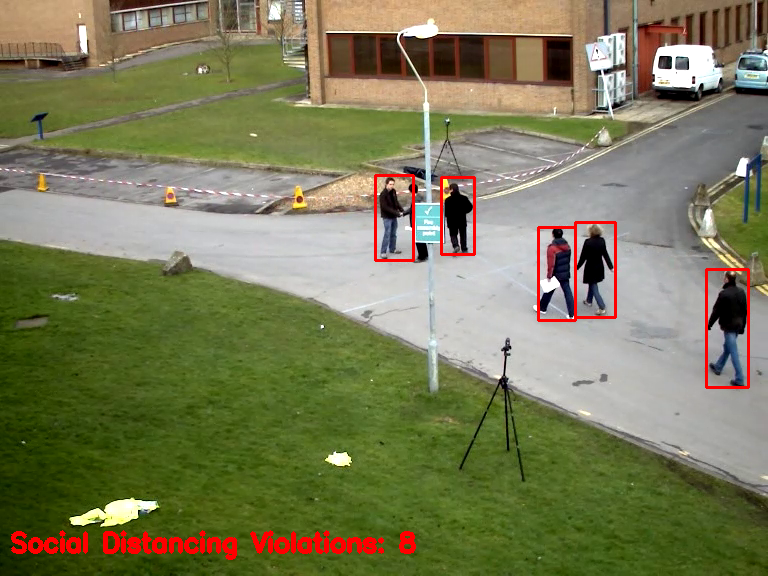

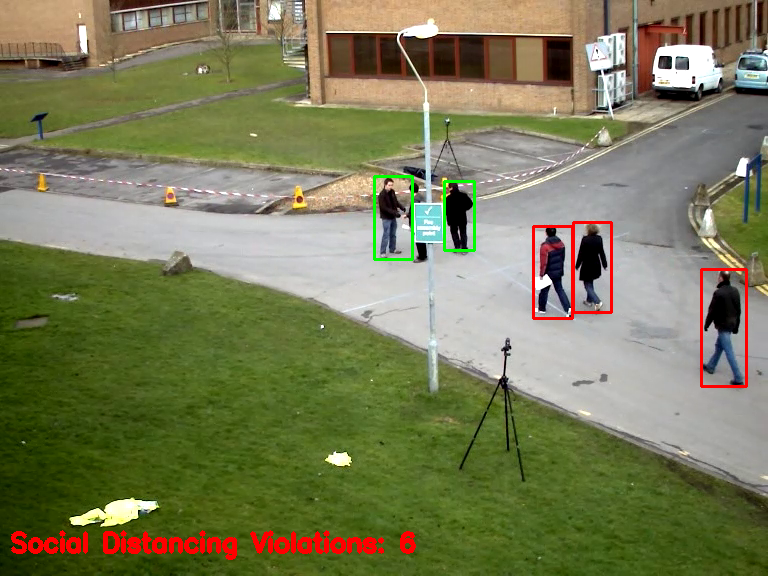

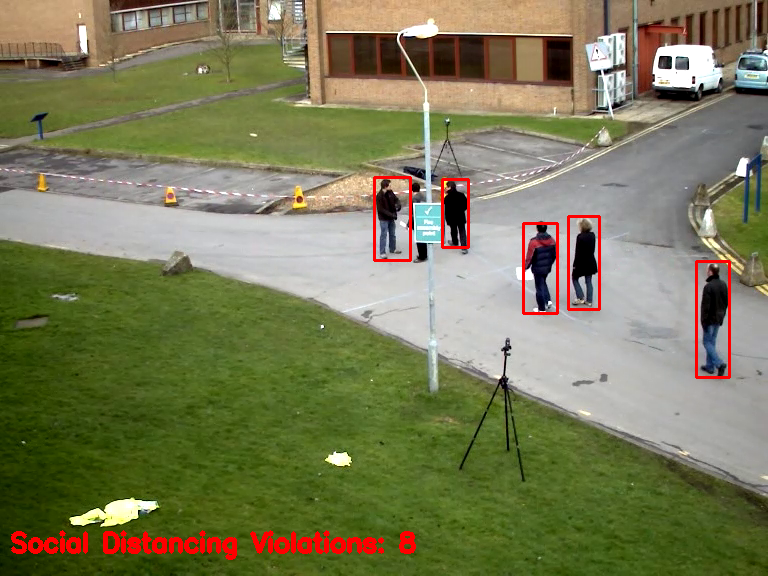

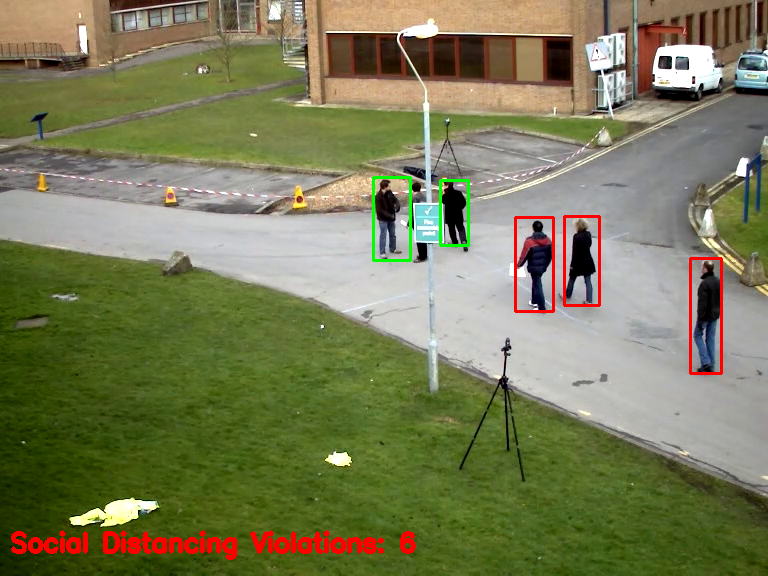

In [ ]:
while (True):
    # read the next frame from the file
    (ret, frame) =cap.read()

    # grab the dimensions of the frame and  initialize the list of results
    (H,W)=frame.shape[0:2]

    #initializing lists
    out=[]
    boxes=[]
    confidences=[]
    centers=[]
    gro_centers=[]
    classIDs=[]

	  # construct a blob from the input frame and then perform a forward pass of the YOLO object detector, giving us our bounding boxes and associated probabilities
    blob = cv2.dnn.blobFromImage(frame, 1 / 255.0, (416, 416),swapRB=True)
    net.setInput(blob)
    layerOutputs = net.forward(ln)

    # loop over each of the layer outputs
    for output in layerOutputs:
      # loop over each of the detections
      for detection in output:
        # extract the class ID and confidence (i.e., probability) of the current object detection
        scores = detection[5:]
        classID = np.argmax(scores)
        confidence = scores[classID]

        # filter out weak predictions by ensuring the detected probability is greater than the minimum probability
        if classID == LABELS.index("person") and confidence > MIN_CONF:
          # scale the bounding box coordinates back relative to the
          # size of the image, keeping in mind that YOLO actually
          # returns the center (x, y)-coordinates of the bounding
          # box followed by the boxes' width and height
          box = detection[0:4] * np.array([W, H, W, H])
          (centerX, centerY, width, height) = box.astype("int")

          # use the center (x, y)-coordinates to derive the top and
          # and left corner of the bounding box
          x = int(centerX - (width / 2))
          y = int(centerY - (height / 2))

          # update our list of bounding box coordinates, confidences, and class IDs
          boxes.append([x, y, int(width), int(height)])
          confidences.append(float(confidence))
          centers.append((centerX,centerY))
          gro_centers.append((centerX,centerY-height))
          classIDs.append(classID)

	  # apply non-maxima suppression to suppress weak, overlapping bounding boxes
    idxs = cv2.dnn.NMSBoxes(boxes, confidences, MIN_CONF, NMS_THRESH)
 
    if len(idxs) > 0:
    # loop over the indexes we are keeping
      for i in idxs.flatten():
        # extract the bounding box coordinates
        (x, y) = (boxes[i][0], boxes[i][1])
        (w, h) = (boxes[i][2], boxes[i][3])
        out.append((confidences[i], (x, y, x + w, y + h),centers[i],gro_centers[i]))
    violate=[]
    if len(out) >= 2:
		# extract all centroids from the results and compute the
		# Euclidean distances between all pairs of the centroids
      centroids = np.array([r[3] for r in out])
      g_mat=[[-0.211332,-0.405226,70.781223],[-0.019746,-1.564936,226.377280],[-0.000025,-0.001961,0.160791]]
      head=[[0.053299,1.247713,13.803214],[-0.092242,1.196431,38.620552],[-0.000080,0.003919,0.164282]]
      mat=np.float32(g_mat)
      new_c=[]
      for x,y in centroids:
        temp=mat @ [x,y,1] 
        new_c.append(temp/temp[2])

      D = dist.cdist(new_c, new_c, metric="euclidean")
      # loop over the upper triangular of the distance matrix
      for i in range(0, D.shape[0]):
        for j in range(i + 1, D.shape[1]):
          # check to see if the distance between any two
          # centroid pairs is less than the configured number
          # of pixels
          if D[i, j] < 150:
            # update our violation set with the indexes of
            # the centroid pairs
            violate.append(i)
            violate.append(j)
    for (i, (prob, bbox, centroid,head_center)) in enumerate(out):
		# extract the bounding box and centroid coordinates, then
		# initialize the color of the annotation
      (startX, startY, endX, endY) = bbox
      (cX, cY) = centroid
      color = (0, 255, 0)
      # if the index pair exists within the violation set, then
      # update the color
      if i in violate:
        color = (0, 0, 255)
      # draw (1) a bounding box around the person and (2) the
      # centroid coordinates of the person,
      cv2.rectangle(frame, (startX, startY), (endX, endY), color, 2)

    text = "Social Distancing Violations: {}".format(len(violate))
    cv2.putText(frame, text, (10, frame.shape[0] - 25), cv2.FONT_HERSHEY_SIMPLEX, 0.85, (0, 0, 255), 3)
 
    cv2_imshow(frame)
    if writer is not None:
      writer.write(frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break